# Block C: Creative Brief Template

Please, use this template to write down your solutions to the [DataLab Tasks](). If you have any questions, please, contact your mentor or the content responsible. 

## Important Notes:
- [ ] Please, rename the file to ```CreativeBrief_<your_name>_<studentnumber>.ipynb``` before submitting it. 
- [ ] Upload this template to the 'Deliverables' folder in you BUas GitHub repository.
- [ ] You are allowed to add as many (Markdown/Python) cells as you need. 
- [ ] If more iteration steps were performed for the tasks in Section 3, please add more iteration sections.
- [ ] If less iteration steps were needed for the tasks in Section 3, please remove the empty iteration sections.
- [ ] If the task requires you to only write code or text, please, delete the unnecessary cell.
- [ ] Your work should be reproducible, meaning that we should be able to run your code in the template and get the same results as you did. Tip: use relative paths to load your data!
- [ ] Ensure that before you hand in the template, you press ```Restart & Run all```; we should be able to see the results of your code in the notebook (i.e., output cells).
- [ ] Ensure that your code in the template is ```error-free```. In other words, we should not see any error messages when we run your code.

In [1]:
#all of the imports needed for the project 
import os
import shutil
import random
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import skimage as ski
from skimage import transform
from sklearn.preprocessing import LabelBinarizer
from keras.utils import to_categorical
from keras.models import Sequential, load_model
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
import tensorflow as tf
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_fscore_support
from tensorflow.keras import layers, models
from matplotlib.image import imread
from tensorflow.keras.preprocessing.image import ImageDataGenerator
os.environ['KMP_DUPLICATE_LIB_OK']='True' # use this because the kernel was crashing a lot 



# Section 1 - Business Understanding (Week 1, Market Research for Product Development, Stakeholders & DAPS)

## Task 1.1: Market Research

__1 What image classifier product or product feature could make organizational life easier?__
- An image classifier tailored for plant identification and classification, with a feature specifically designed to detect endangered plant species. This product feature would streamline conservation efforts by automatically identifying and prioritizing endangered plants, helping organizations focus their resources more efficiently.

__2 How can I improve work within an organization?__

- Implementing the image classifier mentioned above can improve work within an organization by enhancing environmental conservation efforts. By accurately identifying endangered plants and prioritizing their protection, organizations can contribute to biodiversity preservation and fulfill their environmental responsibilities. This not only aligns with corporate social responsibility goals but also fosters a positive organizational culture centered around sustainability.

__3 What problem can I alleviate for an organization?__
- By utilizing the image classifier for plant identification and conservation purposes, you can alleviate the problem of inefficient and resource-intensive manual plant surveys. Traditional methods of identifying endangered plants often require significant time and labor investments. However, with the image classifier, organizations can automate this process, saving time and resources while still effectively contributing to conservation efforts.






## Task 1.2: Stakeholder Analysis

__1. Characteristics__
- Environmental Organizations: Have a strong interest and expertise in plant conservation and biodiversity.
- Government Agencies: Responsible for enacting and enforcing environmental regulations and policies.
- Botanists and Researchers: Possess specialized knowledge and expertise in plant identification and classification.
- Local Communities: May have a vested interest in preserving local plant species and ecosystems.
- Investors and Donors: Provide financial support for conservation initiatives and may influence decision-making.

__2. Prioritization__


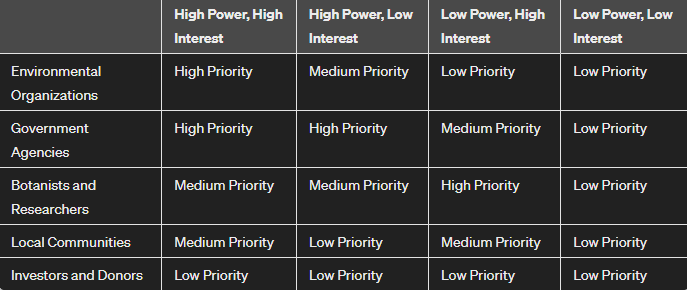

__3. Main stakeholder__
- The main stakeholder for this project is likely to be the Environmental Organizations. Their high interest and expertise in plant conservation make them key stakeholders in any initiatives related to plant identification and biodiversity preservation.

Add additional text here!

## Task 1.3: The DAPS Diagram

https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/08f88fc9ede6940c3cab42163d3706168789e3c3/Deliverables/Final_deliverables/DAPS_diagram.drawio.svg


__1. The data-analytic problem__

Develop an image classifier capable of accurately identifying and categorizing various species of flowers based on input images.

__2. The decision framework__

Select and implement appropriate machine learning algorithms and techniques for image classification, considering factors such as model performance, interpretability, and computational efficiency.

__3. The business value__

Enhance organizational efficiency by automating the process of flower species identification, facilitating tasks such as biodiversity monitoring, conservation efforts, and ecological research.






## Task 1.4: The First Idea

The first idea is to develop an image classifier specifically designed for plant identification, classification, and assessing the endangered status of plant species. This classifier would utilize machine learning algorithms trained on a dataset of labeled plant images to accurately identify various plant species and determine if they are endangered or not. The classifier would be integrated into a user-friendly mobile application, allowing users to take pictures of plants in their surroundings and receive instant identification and endangered status results.

# Section 2A - Responsible AI (Fairness & Bias, Week 1)

## Task 2.1: Create a Dataset 

This code block effectively organizes the flower image dataset into subsets suitable for model training, testing, and validation. It ensures that each subset contains a representative distribution of images from each flower category, facilitating fair and robust model training and evaluation.

In [2]:


# Define the source and destination directories
source_dir = {
    'Accacia_flower': "D://Holland Обучение//Block_C//downloaded_images_Acacia_flower",
    'Cypripedium_calceolus': "D://Holland Обучение//Block_C//downloaded_images_Cypripedium_calceolus",
    'edelvais': "D://Holland Обучение//Block_C//downloaded_images_edelvais",
    'Rose': "D://Holland Обучение//Block_C//downloaded_images_rose_flower",
    'tulips': "D://Holland Обучение//Block_C//downloaded_images_tulips"
}

train_dir = "D://Holland Обучение//Block_C//Dataset//Train 70 %"
test_dir = "D://Holland Обучение//Block_C//Dataset//Test 10 %"
val_dir = "D://Holland Обучение//Block_C//Dataset//Validation 20 %"

# Create destination directories if they don't exist
for directory in [train_dir, test_dir, val_dir]:
    if not os.path.exists(directory):
        os.makedirs(directory)

# Define the percentage split
train_split = 0.7
test_split = 0.1
val_split = 0.2

# Iterate over each flower category
for category in source_dir.keys():
    # Get list of files in the category directory
    category_dir = source_dir[category]
    files = os.listdir(category_dir)
    num_files = len(files)
    
    # Shuffle the files
    random.shuffle(files)
    
    # Calculate split indices
    train_end = int(num_files * train_split)
    test_end = int(num_files * (train_split + test_split))
    
    # Assign files to train, test, and validation sets
    train_files = files[:train_end]
    test_files = files[train_end:test_end]
    val_files = files[test_end:]
    
    # Move files to respective directories
    for file in train_files:
        src = os.path.join(category_dir, file)
        dest = os.path.join(train_dir, category)
        if not os.path.exists(dest):
            os.makedirs(dest)
        shutil.move(src, dest)
        
    for file in test_files:
        src = os.path.join(category_dir, file)
        dest = os.path.join(test_dir, category)
        if not os.path.exists(dest):
            os.makedirs(dest)
        shutil.move(src, dest)
        
    for file in val_files:
        src = os.path.join(category_dir, file)
        dest = os.path.join(val_dir, category)
        if not os.path.exists(dest):
            os.makedirs(dest)
        shutil.move(src, dest)


## Task 2.2: Identify, and Describe Bias

### Bias Identification and Analysis

In this task, we aim to identify and describe any instances of bias present in our flower image dataset. Bias in this context refers to any systematic and unfair influence that may affect the fairness of our model's predictions.

#### Data Distribution Analysis

First, we analyze the distribution of images across different flower categories in our dataset. The bar plot illustrates the number of images for each category in the training, testing, and validation sets. This analysis helps us understand the representation of each category in our dataset.



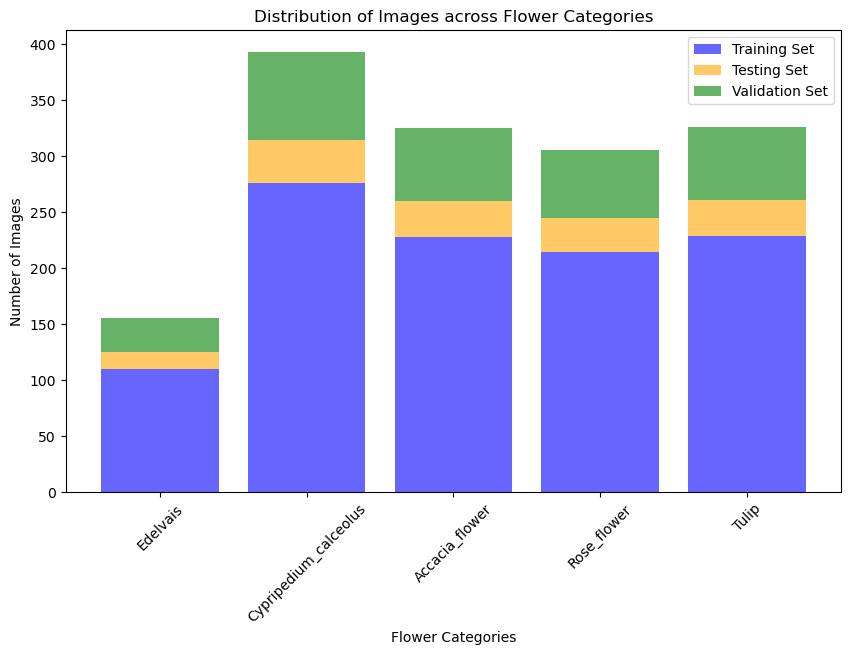

In [3]:

# Flower categories and corresponding counts
categories = ['Edelvais', 'Cypripedium_calceolus', 'Accacia_flower', 'Rose_flower', 'Tulip']
train_counts = [110, 276, 228, 215, 229]
test_counts = [int(151/1060 * count) for count in train_counts]
val_counts = [int(303/1060 * count) for count in train_counts]

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(categories, train_counts, color='blue', alpha=0.6, label='Training Set')
plt.bar(categories, test_counts, color='orange', alpha=0.6, label='Testing Set', bottom=train_counts)
plt.bar(categories, val_counts, color='green', alpha=0.6, label='Validation Set', bottom=[train + test for train, test in zip(train_counts, test_counts)])
plt.xlabel('Flower Categories')
plt.ylabel('Number of Images')
plt.title('Distribution of Images across Flower Categories')
plt.legend()
plt.xticks(rotation=45)
plt.show()

#### Proportion of Images

We calculate the proportion of images for each flower category in the training dataset. This allows us to identify if there are any imbalances in the distribution of images among different categories.


In [4]:
# Counts for each flower category in the training dataset
counts = {
    'Edelvais': 110,
    'Cypripedium_calceolus': 276,
    'Accacia_flower': 228,
    'Rose_flower': 215,
    'Tulip': 229
}

# Total number of images in the training dataset
total_images_train = sum(counts.values())

# Calculate the proportion of images for each category
proportions = {category: count / total_images_train for category, count in counts.items()}

# Print the proportion of images for each category
for category, proportion in proportions.items():
    print(f"Proportion of images for {category}: {proportion:.2%}")

# Calculate the number of images for each category based on the total number of images in the training dataset
num_images_train = {category: int(total_images_train * proportion) for category, proportion in proportions.items()}

# Print the number of images for each category
for category, num_images in num_images_train.items():
    print(f"Number of images for {category} in the training dataset: {num_images}")


Proportion of images for Edelvais: 10.40%
Proportion of images for Cypripedium_calceolus: 26.09%
Proportion of images for Accacia_flower: 21.55%
Proportion of images for Rose_flower: 20.32%
Proportion of images for Tulip: 21.64%
Number of images for Edelvais in the training dataset: 110
Number of images for Cypripedium_calceolus in the training dataset: 276
Number of images for Accacia_flower in the training dataset: 228
Number of images for Rose_flower in the training dataset: 215
Number of images for Tulip in the training dataset: 229


## Bias Analysis of Flower Image Dataset

### Identified Biases:

1. **Imbalance in Proportions**:
   - The proportions of images for each flower category vary, indicating an unequal representation of categories in the dataset.

2. **Underrepresentation of Edelvais**:
   - Edelvais has the lowest proportion and number of images in the training dataset, potentially leading to poor model performance in recognizing this flower category.

3. **Overrepresentation of Cypripedium_calceolus**:
   - Cypripedium_calceolus has the highest proportion and number of images in the training dataset, which may result in biased predictions towards this category.

### Potential Impact:
   - These biases could lead to unfair outcomes, such as misclassification or underestimation of underrepresented categories like Edelvais and overemphasis on overrepresented categories like Cypripedium_calceolus.

### Mitigation Strategies:
   - Addressing these biases may involve strategies such as collecting more data for underrepresented categories, augmenting images to increase the diversity within each category, or applying techniques to balance the dataset's representation across all categories.


#### Proportion of the images in the dataset represented with a Pie Chart

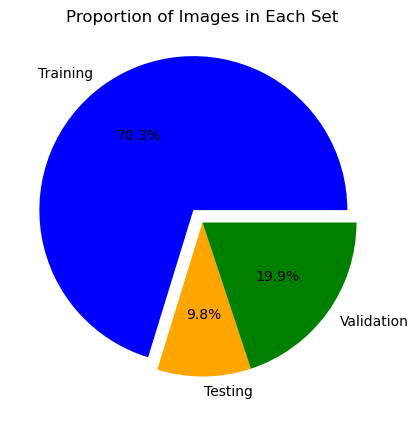

In [5]:
# Proportion of images in each set
total_train = sum(train_counts)
total_test = sum(test_counts)
total_val = sum(val_counts)
total_images = total_train + total_test + total_val

train_proportion = total_train / total_images
test_proportion = total_test / total_images
val_proportion = total_val / total_images

# Plotting
plt.figure(figsize=(8, 5))
plt.pie([train_proportion, test_proportion, val_proportion], labels=['Training', 'Testing', 'Validation'], autopct='%1.1f%%', colors=['blue', 'orange', 'green'], explode=(0.1, 0, 0))
plt.title('Proportion of Images in Each Set')
plt.show()


#### Visualization of Sample Images

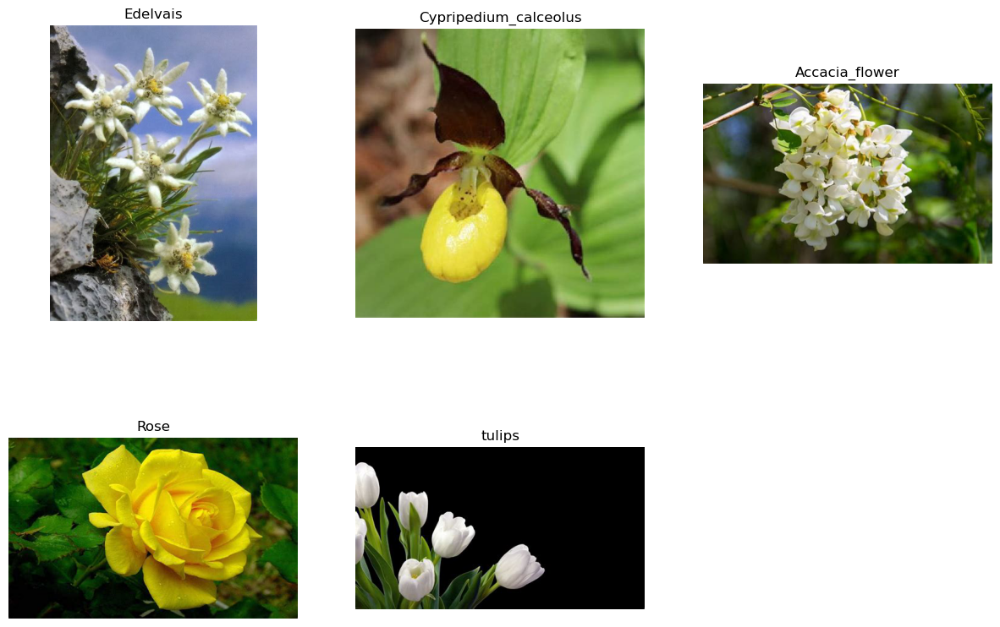

In [6]:

# Define the directory containing the dataset
dataset_dir = "D://Holland Обучение//Block_C//Dataset//Train 70 %"

# Define flower categories
flower_categories = ['Edelvais', 'Cypripedium_calceolus', 'Accacia_flower', 'Rose', 'tulips']

# Plotting
plt.figure(figsize=(15, 10))

# Loop through each category
for i, category in enumerate(flower_categories):
    # Get the directory for the current category
    category_dir = os.path.join(dataset_dir, category)
    
    # Check if the directory exists
    if os.path.exists(category_dir):
        # Get a list of all image files in the directory
        image_files = [file for file in os.listdir(category_dir) if file.endswith(('.jpg', '.png'))]
        
        # Check if there are any valid image files
        if image_files:
            # Select a random image from the list
            random_image = random.choice(image_files)
            image_path = os.path.join(category_dir, random_image)

            # Read and plot the image
            image = imread(image_path)

            plt.subplot(2, 3, i+1)
            plt.imshow(image)
            plt.title(category)
            plt.axis('off')
        else:
            print(f"No valid image files found in '{category}' directory.")
    else:
        print(f"Directory '{category}' not found.")

plt.show()


## Task 2.3: Propose Individual Fairness Method

Introduction:
We propose employing Fairness Through Awareness to address bias in the distribution of flower types. This method involves augmenting images of underrepresented flower types, such as Edelvais, Rose_flower, and Tulip.

Elaboration:
By augmenting images of underrepresented flower types, we aim to achieve a more balanced distribution in the dataset. This approach directly mitigates bias related to unequal proportions of images for each flower type.

Effectiveness:
Fairness Through Awareness promotes fairness by ensuring equal representation of all flower types. This method actively addresses bias, leading to more equitable machine learning models without removing sensitive attributes.

In summary, Fairness Through Awareness via data augmentation is an effective approach to promote individual fairness and reduce the risk of biased predictions.



## Task 2.4: Create Infographic; Group Fairness Metrics

__1. Strengths__

Visually appealing design with clear layout and easy-to-understand graphics.
Concise and relevant information presented effectively, enhancing comprehension.
Effective use of color scheme and typography to highlight key points and maintain reader engagement.
Now, let's address areas for improvement:

__2. Areas for Improvement__

The infographic could benefit from more diversity in data visualization techniques to convey information more dynamically.
Providing additional context or explanations for certain data points could enhance clarity and understanding for the audience.
Ensuring consistency in design elements throughout the infographic could improve overall cohesiveness and professionalism.
For the next steps for improvement:

__3. Next Steps for Improvement__

Consider incorporating interactive elements or animations to make the infographic more engaging and interactive.
Add brief captions or annotations to clarify complex data points and provide context for the audience.
Review and refine design elements for consistency in style, color, and typography to maintain visual coherence.
Finally, for your reflection:

__4. Reflection__

I appreciate the feedback provided by my peer reviewer, Ron Lev Tabuchov, which highlighted both the strengths and areas for improvement in my infographic.
Moving forward, I plan to implement the suggested improvements to enhance the effectiveness and visual appeal of the infographic.
Overall, the peer review process has been valuable in identifying areas where my infographic can be strengthened, and I look forward to applying these insights in future projects.





__5. Infographic__
[- \[Presentation\]](https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/Deliverables/Final_deliverables/Dark%20Blue%20Artificial%20Intelligence%20Modern%20and%20Futuristic%20Infographic.pdf)

## Task 2.5: Write Python Function; Group Fairness Taxonomy

Add your text here! (e.g., links to Jupyter Notebook or Python script(s), and model weight file or confusion matrices of the two test sets).

# Section 2B - Responsible AI (Transparency & Interpretability, Week 6)

## Task 2.6: Apply One/Multiple Explainable AI Method(s) to the Image Classifier

1. **Local Interpretable Model-agnostic Explanations (LIME):**

- Strengths:
    - Provides locally faithful explanations for individual predictions.
    - Model-agnostic, meaning it can be applied to any machine learning model.
    - Works well for image classifiers by generating interpretable explanations at the pixel level.
- Weaknesses:
    - Computationally expensive, especially for large and complex models.
    - The quality of explanations may vary based on the choice of sampling method and interpretability algorithm.
2. **SHAP (SHapley Additive exPlanations):**

-Strengths:
    - Based on game theory principles, providing theoretically grounded explanations.
    - Can handle both local and global explanations, offering insights into feature importance at various levels.
    - Efficiently handles high-dimensional data like images.
- Weaknesses:
    - Complexity can make it challenging to interpret for non-experts.
    - Computationally expensive for large datasets and models.
3. **Grad-CAM (Gradient-weighted Class Activation Mapping):**

- Strengths:
    - Provides visual explanations by highlighting important regions of the input image for model predictions.
    - Easy to implement and interpret, as it directly overlays heatmaps onto input images.
    - Helps users understand where the model is focusing its attention.
- Weaknesses:
    - Limited to convolutional neural networks (CNNs) and may not work well with other types of models.
    - May not always capture nuanced features or dependencies in the data.
    
**Trade-off between Accuracy and Interpretability:**
In the context of our classification model and task, achieving a high level of accuracy is crucial to ensure the model's effectiveness in making correct predictions. However, interpretability is also essential, especially in domains where model decisions impact human lives or where regulatory compliance is required. Therefore, there is a trade-off between accuracy and interpretability, and the balance between the two depends on the specific requirements of the application.

**Choice of XAI Method(s):**
Given the need for interpretability without compromising too much on accuracy, Grad-CAM seems to be a suitable choice. It provides visual explanations that are relatively easy to interpret and can help users understand the model's decision-making process. Additionally, since Grad-CAM works well with CNNs, which are commonly used in image classification tasks, it aligns well with our classification model.



# Section 3 - Neural Networks and Deep Learning (Weeks 2 to 5)

## Task 3.1: Baselines

### 1. Random Guess Accuracy

This code provides a simple and efficient method to compute the random guess accuracy for a classification task based on the distribution of images across different classes in the dataset.

In [7]:
# Proportion of images for each class
class_proportions = {
    'Edelvais': 0.104,
    'Cypripedium_calceolus': 0.2609,
    'Accacia_flower': 0.2155,
    'Rose_flower': 0.2032,
    'Tulip': 0.2164
}

# Find the most occurring class
most_occurring_class = max(class_proportions, key=class_proportions.get)

# Calculate random guess accuracy
random_guess_accuracy = class_proportions[most_occurring_class]

print("Random Guess Accuracy:", random_guess_accuracy)


Random Guess Accuracy: 0.2609


### Class Proportions

- Edelvais: 10.40%
- Cypripedium_calceolus: 26.09%
- Accacia_flower: 21.55%
- Rose_flower: 20.32%
- Tulip: 21.64%

The random guess accuracy is equal to the proportion of the most occurring class: 26.09%.

### 2. Human-Level Performance Accuracy

- Human level Performace accuarcy is 66,07 % -
https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/Flower_Recognition%C2%A0.xlsx

I calculated using all the results and dividng them by the number of people that did the survey. 

### 3. Basic Multilayer Perceptron Accuracy

In [8]:
#This code snippet defines directory paths for the train, test, and validation subsets of the dataset.
train_dir = "D://Holland Обучение//Block_C//Dataset//Train 70 %"
test_dir = "D://Holland Обучение//Block_C//Dataset//Test 10 %"
val_dir = "D://Holland Обучение//Block_C//Dataset//Validation 20 %"

- The function loads images from specified folders, resizes them to a common size, and performs basic preprocessing.
- It returns preprocessed image data (`X`), encoded labels (`y`), and class names (`class_names`).

In [9]:


def dataset_basic_multilayer(folder_path, height, width, channels):
    folder_paths = [
        os.path.join(folder_path, "Accacia_flower"),
        os.path.join(folder_path, "Cypripedium_calceolus"),
        os.path.join(folder_path, "edelvais"),
        os.path.join(folder_path, "Rose"),
        os.path.join(folder_path, "tulips"),
    ]

    class_names = [
        "Accacia_flower",
        "Cypripedium_calceolus",
        "edelvais",
        "Rose",
        "tulips",
    ]
    X = []
    y = []

    for i in range(len(folder_paths)):
        for filename in os.listdir(folder_paths[i]):
            file_extension = os.path.splitext(filename)[1]
            if file_extension.lower() in [".jpg", ".jpeg", ".png"]:
                image_filename = os.path.join(folder_paths[i], filename)
                image = ski.io.imread(image_filename)
                image_resized = ski.transform.resize(image, (height, width, channels))
                X.append(image_resized)
                y.append(class_names[i])

    X = np.array(X)
    y = np.array(y)
    
    # One-hot encode the labels
    label_binarizer = LabelBinarizer()
    y = label_binarizer.fit_transform(y)

    return X, y, label_binarizer.classes_


- The code loads and preprocesses the training dataset using the specified parameters.
- It prints the shapes of the preprocessed image data and one-hot encoded labels, along with the class names.

In [10]:
folder_path = train_dir
height = 64
width = 64
channels = 3

X_train, y_train, class_names = dataset_basic_multilayer(folder_path, height, width, channels)

print("Shape of X:", X_train.shape)
print("Shape of y_one_hot:", y_train)
print("Class names:", class_names)

Shape of X: (1046, 64, 64, 3)
Shape of y_one_hot: [[1 0 0 0 0]
 [1 0 0 0 0]
 [1 0 0 0 0]
 ...
 [0 0 0 0 1]
 [0 0 0 0 1]
 [0 0 0 0 1]]
Class names: ['Accacia_flower' 'Cypripedium_calceolus' 'Rose' 'edelvais' 'tulips']


This code snippet loads and preprocesses the test dataset using the `dataset_basic_multilayer` function.

In [11]:
folder_path = test_dir
height = 64
width = 64
channels = 3

X_test, y_test, class_names = dataset_basic_multilayer(folder_path, height, width, channels)

print("Shape of X:", X_test.shape)
print("Shape of y_one_hot:", y_test.shape)
print("Class names:", class_names)

Shape of X: (146, 64, 64, 3)
Shape of y_one_hot: (146, 5)
Class names: ['Accacia_flower' 'Cypripedium_calceolus' 'Rose' 'edelvais' 'tulips']


This code snippet loads and preprocesses the validation dataset using the `dataset_basic_multilayer` function.

In [12]:
folder_path = val_dir
height = 64
width = 64
channels = 3

X_val, y_val, class_names = dataset_basic_multilayer(folder_path, height, width, channels)

print("Shape of X:", X_val.shape)
print("Shape of y_one_hot:", y_val)
print("Class names:", class_names)

Shape of X: (298, 64, 64, 3)
Shape of y_one_hot: [[1 0 0 0 0]
 [1 0 0 0 0]
 [1 0 0 0 0]
 ...
 [0 0 0 0 1]
 [0 0 0 0 1]
 [0 0 0 0 1]]
Class names: ['Accacia_flower' 'Cypripedium_calceolus' 'Rose' 'edelvais' 'tulips']


This code snippet reshapes the training and test data arrays to flatten them into a 1-dimensional format.

In [13]:
X_train = X_train.reshape(-2, 12288)
X_test = X_test.reshape(-2, 12288)

This function builds a neural network model using the Keras Sequential API. It consists of an input layer, two hidden layers with ReLU activation, and an output layer with softmax activation for multi-class classification.


In [14]:


def build_model(print_summary=False):
    model = Sequential()
    # Add the input layer and the first hidden layer
    model.add(Dense(64, activation='relu', input_shape=(12288,)))
    # Add the second hidden layer
    model.add(Dense(32, activation='relu'))
    # Add the output layer
    model.add(Dense(5, activation='softmax'))
    # Display summary is optional
    if print_summary:
        model.summary()
    return model

model = build_model(print_summary=True)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                786496    
                                                                 
 dense_1 (Dense)             (None, 32)                2080      
                                                                 
 dense_2 (Dense)             (None, 5)                 165       
                                                                 
Total params: 788,741
Trainable params: 788,741
Non-trainable params: 0
_________________________________________________________________


In [15]:
# compiling the model  

def compile_model(model, lr):
    # Instantiate Adam optimizer with the provided learning rate
    opt = Adam(learning_rate=lr)
    
    # Compile the model with categorical crossentropy loss and the Adam optimizer
    model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Compile the model with learning rate lr=0.001
model = compile_model(model, lr=0.001)

In [16]:
# training the model 
H = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=30, batch_size=32)

Epoch 1/30
33/33 [==============================] - 2s 25ms/step - loss: 2.0249 - accuracy: 0.2782 - val_loss: 1.3772 - val_accuracy: 0.3219
Epoch 2/30
33/33 [==============================] - 0s 5ms/step - loss: 1.2766 - accuracy: 0.4054 - val_loss: 1.2008 - val_accuracy: 0.3904
Epoch 3/30
33/33 [==============================] - 0s 5ms/step - loss: 1.1586 - accuracy: 0.4904 - val_loss: 1.0987 - val_accuracy: 0.5616
Epoch 4/30
33/33 [==============================] - 0s 6ms/step - loss: 1.0826 - accuracy: 0.5210 - val_loss: 1.0749 - val_accuracy: 0.5548
Epoch 5/30
33/33 [==============================] - 0s 5ms/step - loss: 1.0225 - accuracy: 0.5468 - val_loss: 1.0727 - val_accuracy: 0.5274
Epoch 6/30
33/33 [==============================] - 0s 6ms/step - loss: 0.9524 - accuracy: 0.5841 - val_loss: 0.9591 - val_accuracy: 0.6096
Epoch 7/30
33/33 [==============================] - 0s 6ms/step - loss: 0.8949 - accuracy: 0.6367 - val_loss: 0.9646 - val_accuracy: 0.5616
Epoch 8/30
33/33 [=

## Task 3.2 Preprocessing

In [17]:
# I pasted the paths from above so I can acces them easier when building each iteration 
train_dir = "D://Holland Обучение//Block_C//Dataset//Train 70 %"
test_dir = "D://Holland Обучение//Block_C//Dataset//Test 10 %"
val_dir = "D://Holland Обучение//Block_C//Dataset//Validation 20 %"

### Iteration 1

Bsic Itteration with 128X128 

In [18]:

def dataset(folder_path, height, width, channels):
    folder_paths = [
        os.path.join(folder_path, "Accacia_flower"),
        os.path.join(folder_path, "Cypripedium_calceolus"),
        os.path.join(folder_path, "edelvais"),
        os.path.join(folder_path, "Rose"),
        os.path.join(folder_path, "tulips"),
    ]

    class_names = [
        "Accacia_flower",
        "Cypripedium_calceolus",
        "edelvais",
        "Rose",
        "tulips",
    ]
    X = []
    y = []

    for i in range(len(folder_paths)):
        for filename in os.listdir(folder_paths[i]):
            file_extension = os.path.splitext(filename)[1]
            if file_extension.lower() in [".jpg", ".jpeg", ".png"]:
                image_filename = os.path.join(folder_paths[i], filename)
                image = ski.io.imread(image_filename)
                # Resize image to desired dimensions (128x128)
                image_resized = ski.transform.resize(image, (height, width, channels))
                X.append(image_resized)
                y.append(class_names[i])

    X = np.array(X)
    y = np.array(y)
    
    # One-hot encode the labels
    label_binarizer = LabelBinarizer()
    y = label_binarizer.fit_transform(y)
    return X, y, label_binarizer.classes_





- Loading the model and defining the pixels

In [19]:
# Define the new dimensions for preprocessing
height = 128
width = 128
channels = 3

# Version 1 dataset
V1_X_train, V1_y_train, class_names = dataset(train_dir, height, width, channels)
V1_X_test, V1_y_test, class_names = dataset(test_dir, height, width, channels)
V1_X_val, V1_y_val, class_names = dataset(val_dir, height, width, channels)

### Iteration 2

basic Iteration with 256X256 

In [20]:

height = 256 
width = 256
channels = 3

# Version 2 dataset
V2_X_train, V2_y_train, class_names = dataset(train_dir, height, width, channels)
V2_X_test, V2_y_test, class_names = dataset(test_dir, height, width, channels)
V2_X_val, V2_y_val, class_names = dataset(val_dir, height, width, channels)

### Iteration 3

Augmented images 

In [21]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def dataset_augmentation(folder_path, height, width, channels, augmentation=False, target_samples=300):
    folder_paths = [
        os.path.join(folder_path, "Accacia_flower"),
        os.path.join(folder_path, "Cypripedium_calceolus"),
        os.path.join(folder_path, "edelvais"),
        os.path.join(folder_path, "Rose"),
        os.path.join(folder_path, "tulips"),
    ]

    class_names = [
        "Accacia_flower",
        "Cypripedium_calceolus",
        "edelvais",
        "Rose",
        "tulips",
    ]
    X = []
    y = []

    for i in range(len(folder_paths)):
        class_count = 0
        while class_count < target_samples:
            for filename in os.listdir(folder_paths[i]):
                file_extension = os.path.splitext(filename)[1]
                if file_extension.lower() in [".jpg", ".jpeg", ".png"]:
                    image_filename = os.path.join(folder_paths[i], filename)
                    image = ski.io.imread(image_filename)
                    
                    # Resize image to desired dimensions (128x128)
                    image_resized = ski.transform.resize(image, (height, width, channels))
                    X.append(image_resized)
                    y.append(class_names[i])
                    class_count += 1

                    if augmentation and class_count < target_samples:
                        # Create an ImageDataGenerator instance with saturation adjustment and horizontal flip
                        datagen = ImageDataGenerator(
                            rotation_range=20,
                            width_shift_range=0.2,
                            height_shift_range=0.2,
                            horizontal_flip=True,
                            fill_mode='nearest'
                        )

                        # Reshape image for augmentation
                        image_aug = image_resized.reshape((1,) + image_resized.shape)

                        # Generate augmented images
                        augmented_images = datagen.flow(image_aug, batch_size=1)

                        # Append augmented images and their labels
                        for aug_img in augmented_images:
                            X.append(aug_img[0])
                            y.append(class_names[i])
                            class_count += 1
                            if class_count >= target_samples:
                                break

    X = np.array(X)
    y = np.array(y)
    
    # One-hot encode the labels
    label_binarizer = LabelBinarizer()
    y = label_binarizer.fit_transform(y)
    return X, y, label_binarizer.classes_


In [22]:
# Define the new dimensions for preprocessing
height = 128
width = 128
channels = 3

# Augment the dataset to ensure each class has at least 300 images
augmented_X_train, augmented_y_train, class_names = dataset_augmentation(train_dir, height, width, channels, augmentation=True, target_samples=300)


Printing some of the images to see if the code actually augmented any of them 

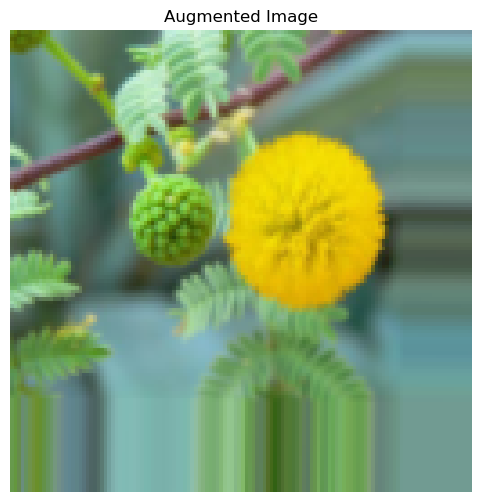

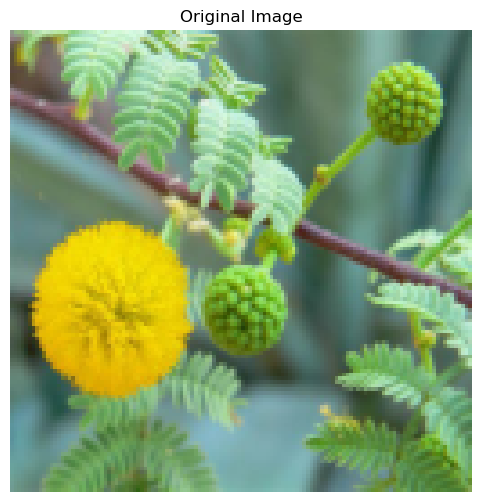

In [23]:
# Print one augmented image
plt.figure(figsize=(6, 6))
plt.imshow(augmented_X_train[1])
plt.title("Augmented Image")
plt.axis('off')
plt.show()

# Print one original image
plt.figure(figsize=(6, 6))
plt.imshow(augmented_X_train[0])
plt.title("Original Image")
plt.axis('off')
plt.show()


### Iteration 4

Transfer Learning  using VVgg 16  model 

In [24]:

# Define the new dimensions for preprocessing
height = 224
width = 224
channels = 3

# Load dataset
V4_X_train, V4_y_train, class_names = dataset(train_dir, height, width, channels)
V4_X_test, V4_y_test, class_names = dataset(test_dir, height, width, channels)
V4_X_val, V4_y_val, class_names = dataset(val_dir, height, width, channels)

# Preprocess input data and train the model (assuming these steps are already defined)
# V4_X_train_preprocessed = preprocess_input(V4_X_train)
# V4_X_test_preprocessed = preprocess_input(V4_X_test)
# V4_X_val_preprocessed = preprocess_input(V4_X_val)



I miltiplied by 255 to make my preprocessed dataset work before that when I used it I got a pitch black screen. 

In [25]:
V4_X_train_preprocessed = preprocess_input(V4_X_train*255)
V4_X_test_preprocessed = preprocess_input(V4_X_test*255)
V4_X_val_preprocessed = preprocess_input(V4_X_val*255)

Printing the shape of the prepocesed images to see if anything is wrong 

In [26]:
print(V4_X_train.shape, V4_y_train.shape ,V4_X_test.shape, V4_y_test.shape)

(1046, 224, 224, 3) (1046, 5) (146, 224, 224, 3) (146, 5)


Plotting the prprocessed image to see if it actually works.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


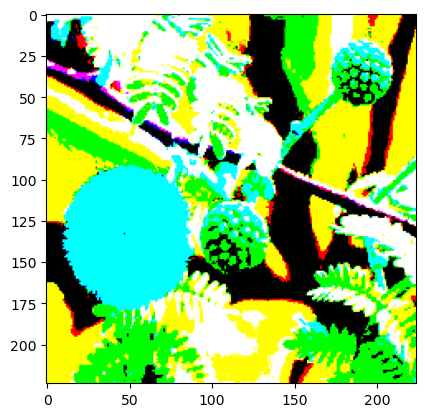

In [27]:
plt.imshow(V4_X_train_preprocessed[0])

## Task 3.3 CNN Architecture

### Iteration 1

- This architecture starts with smaller filters and increases the number of filters in subsequent layers.
- Max pooling and dropout layers are used for regularization and reducing overfitting.
- The architecture ends with a dense layer for classification.

In [37]:


def build_cnn_model(input_shape):
    model = Sequential()
    
    # Convolutional layer 1
    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Convolutional layer 2
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Convolutional layer 3
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Flatten layer
    model.add(Flatten())
    
    # Dense (fully connected) layer
    model.add(Dense(512, activation='relu'))
    model.add(Dropout(0.5))
    
    # Output layer
    model.add(Dense(5, activation='softmax'))
    
    return model

# Assuming input shape is (height, width, channels) for your images
input_shape = (128, 128, 3)

# Build CNN model
V1_model = build_cnn_model(input_shape)

# Print model summary
V1_model.summary()


Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_11 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 63, 63, 32)       0         
 g2D)                                                            
                                                                 
 dropout_16 (Dropout)        (None, 63, 63, 32)        0         
                                                                 
 conv2d_12 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 30, 30, 64)       0         
 g2D)                                                            
                                                                 
 dropout_17 (Dropout)        (None, 30, 30, 64)       

### Iteration 2

- This architecture builds upon the previous version with larger filters and more convolutional layers.
- Max pooling and dropout layers continue to be used for regularization and reducing overfitting.
- The architecture ends with a dense layer for classification.

In [29]:

def build_cnn_model(input_shape):
    model = Sequential()
    
    # Convolutional layer 1
    model.add(Conv2D(64, (3, 3), activation='relu', input_shape=input_shape))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Convolutional layer 2
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Convolutional layer 3
    model.add(Conv2D(256, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))

    model.add(Conv2D(512, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Flatten layer
    model.add(Flatten())
    
    # Dense (fully connected) layer
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.5))
    
    # Output layer
    model.add(Dense(5, activation='softmax'))
    
    return model

# Assuming input shape is (height, width, channels) for your images
input_shape = (256, 256, 3)

# Build CNN model
V2_model = build_cnn_model(input_shape)

# Print model summary
V2_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 254, 254, 64)      1792      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 127, 127, 64)     0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 127, 127, 64)      0         
                                                                 
 conv2d_4 (Conv2D)           (None, 125, 125, 128)     73856     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 62, 62, 128)      0         
 2D)                                                             
                                                                 
 dropout_5 (Dropout)         (None, 62, 62, 128)      

### Iteration 3

- This architecture extends the previous version with additional dense layers for deeper representation learning.
- Dropout layers are used for regularization and reducing overfitting.
- The architecture ends with a dense layer for classification.

In [43]:
input_shape = (128, 128, 3)

# Build CNN model

def build_cnn_model(input_shape):
    model = Sequential()
    
    # Convolutional layer 1
    model.add(Conv2D(64, (3, 3), activation='relu', input_shape=input_shape))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Convolutional layer 2
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Convolutional layer 3
    model.add(Conv2D(256, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))

    model.add(Conv2D(512, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    
    # Flatten layer
    model.add(Flatten())
    
    # Dense (fully connected) layer
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.5))

    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5))

    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.5))
    
    # Output layer
    model.add(Dense(5, activation='softmax'))
    
    return model

# Assuming input shape is (height, width, channels) for your images
input_shape = (128, 128, 3)

# Build CNN model
V3_model = build_cnn_model(input_shape)

# Print model summary
V3_model.summary()
# Print model summary

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_14 (Conv2D)          (None, 126, 126, 64)      1792      
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 63, 63, 64)       0         
 g2D)                                                            
                                                                 
 dropout_20 (Dropout)        (None, 63, 63, 64)        0         
                                                                 
 conv2d_15 (Conv2D)          (None, 61, 61, 128)       73856     
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 30, 30, 128)      0         
 g2D)                                                            
                                                                 
 dropout_21 (Dropout)        (None, 30, 30, 128)      

### Iteration 4

- This model leverages the pre-trained VGG16 architecture for feature extraction.
- The base model's weights are frozen, preventing further training.
- Additional dense layers are added for classification.

In [46]:
# Loading VGG16 model


base_model = VGG16(weights="imagenet", include_top=False, input_shape=(224, 224, channels))
base_model.trainable = False  # Not trainable weights

flatten_layer = layers.Flatten()
dense_layer_1 = layers.Dense(50, activation='relu')
dense_layer_2 = layers.Dense(20, activation='relu')
prediction_layer = layers.Dense(5, activation='softmax')

model_V4 = models.Sequential([
    base_model,
    flatten_layer,
    dense_layer_1,
    dense_layer_2,
    prediction_layer
])
model_V4.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_6 (Flatten)         (None, 25088)             0         
                                                                 
 dense_20 (Dense)            (None, 50)                1254450   
                                                                 
 dense_21 (Dense)            (None, 20)                1020      
                                                                 
 dense_22 (Dense)            (None, 5)                 105       
                                                                 
Total params: 15,970,263
Trainable params: 1,255,575
Non-trainable params: 14,714,688
_________________________________________________________________


## Task 3.4 CNN Training

### Iteration 1

- The model is trained for 20 epochs with a batch size of 64.
- Learning curves are plotted to monitor the training and validation performance.

Epoch 1/20
17/17 [==============================] - 2s 69ms/step - loss: 1.8273 - accuracy: 0.2514 - val_loss: 1.5672 - val_accuracy: 0.3926
Epoch 2/20
17/17 [==============================] - 1s 54ms/step - loss: 1.3879 - accuracy: 0.4273 - val_loss: 1.2347 - val_accuracy: 0.5067
Epoch 3/20
17/17 [==============================] - 1s 54ms/step - loss: 1.1190 - accuracy: 0.5191 - val_loss: 1.0412 - val_accuracy: 0.6007
Epoch 4/20
17/17 [==============================] - 1s 55ms/step - loss: 0.9065 - accuracy: 0.6358 - val_loss: 0.8350 - val_accuracy: 0.7013
Epoch 5/20
17/17 [==============================] - 1s 54ms/step - loss: 0.7926 - accuracy: 0.7055 - val_loss: 0.7736 - val_accuracy: 0.7248
Epoch 6/20
17/17 [==============================] - 1s 53ms/step - loss: 0.6978 - accuracy: 0.7304 - val_loss: 0.6897 - val_accuracy: 0.7483
Epoch 7/20
17/17 [==============================] - 1s 40ms/step - loss: 0.6510 - accuracy: 0.7428 - val_loss: 0.6947 - val_accuracy: 0.7450
Epoch 8/20
17

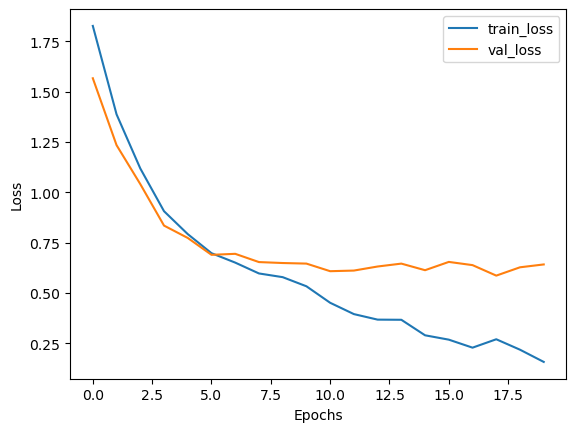

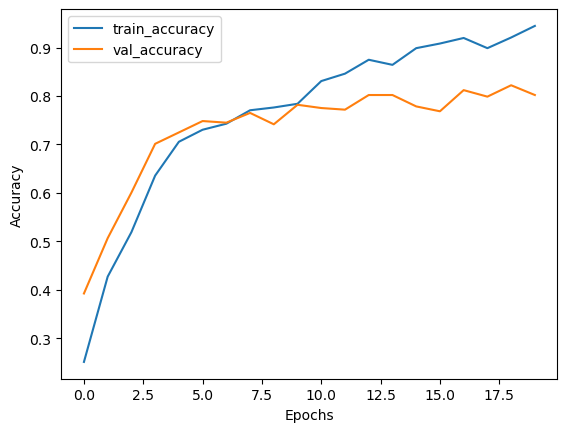

In [38]:

# Define learning rate
learning_rate = 0.001

# Compile the model with categorical crossentropy loss and Adam optimizer
       
V1_model.compile(optimizer=Adam(learning_rate=learning_rate),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

# Define callbacks
callbacks = [
    ModelCheckpoint(filepath='best_model.h5', save_best_only=True),
    EarlyStopping(monitor='val_accuracy', patience=5)
]

# Train the model

history = V1_model.fit(V1_X_train, V1_y_train,
                        validation_data=(V1_X_val, V1_y_val),
                        epochs=20, batch_size=64,
                        callbacks=callbacks)

# Plot learning curves
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(history.history['accuracy'], label='train_accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

### Iteration 2

- **Learning Rate**: Set at 0.001 for the Adam optimizer.
- **Model Compilation**: Compiled with categorical crossentropy loss and Adam optimizer.
- **Callbacks**: Utilized ModelCheckpoint and EarlyStopping.
- **Training**: Conducted over 20 epochs with a batch size of 32.
- **Evaluation**: Training and validation loss, as well as accuracy, monitored.
- Installed Tenserflow for maximum speed while training the models 

Epoch 1/20
33/33 [==============================] - 11s 325ms/step - loss: 2.0101 - accuracy: 0.2964 - val_loss: 1.1182 - val_accuracy: 0.5235
Epoch 2/20
33/33 [==============================] - 8s 236ms/step - loss: 1.0905 - accuracy: 0.5315 - val_loss: 0.9608 - val_accuracy: 0.5671
Epoch 3/20
33/33 [==============================] - 8s 238ms/step - loss: 0.9428 - accuracy: 0.6061 - val_loss: 0.8317 - val_accuracy: 0.6745
Epoch 4/20
33/33 [==============================] - 7s 220ms/step - loss: 0.8463 - accuracy: 0.6663 - val_loss: 0.8553 - val_accuracy: 0.6745
Epoch 5/20
33/33 [==============================] - 8s 233ms/step - loss: 0.7842 - accuracy: 0.7342 - val_loss: 0.7560 - val_accuracy: 0.7081
Epoch 6/20
33/33 [==============================] - 8s 232ms/step - loss: 0.6813 - accuracy: 0.7495 - val_loss: 0.7150 - val_accuracy: 0.7383
Epoch 7/20
33/33 [==============================] - 8s 233ms/step - loss: 0.6363 - accuracy: 0.7696 - val_loss: 0.6572 - val_accuracy: 0.7651
Epoch

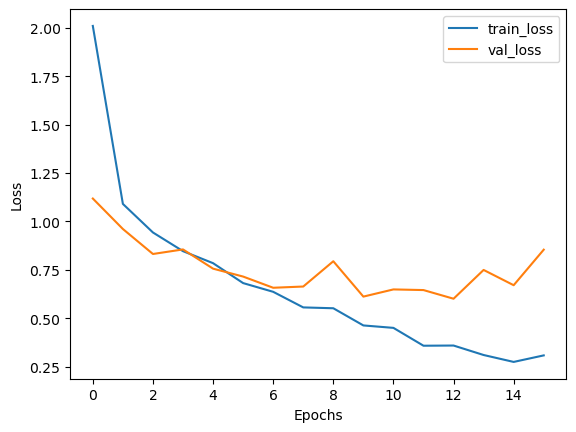

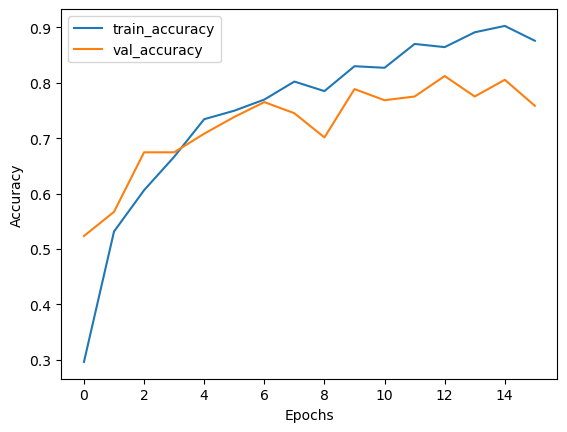

In [33]:


# Define learning rate
learning_rate = 0.001

# Compile the model within the specified device

V2_model.compile(optimizer=Adam(learning_rate=learning_rate),
                      loss='categorical_crossentropy',
                      metrics=['accuracy'])

# Define callbacks
callbacks = [
    ModelCheckpoint(filepath='best_model.h5', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=3)
]

# Train the model within the specified device

history = V2_model.fit(V2_X_train, V2_y_train,
                            validation_data=(V2_X_val, V2_y_val),
                            epochs=20, batch_size=32,
                            callbacks=callbacks)

# Plot learning curves
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(history.history['accuracy'], label='train_accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

### Iteration 3



- **Learning Rate**: 0.001
- **Compiled with**: Adam optimizer and categorical crossentropy loss.
- **Callbacks**: ModelCheckpoint and EarlyStopping.
- **Batch Size**: Reduced to 16.
- **Epochs**: 20
- **Data**: Augmented training set, original validation set.

Epoch 1/20
159/159 [==============================] - 6s 31ms/step - loss: 1.4615 - accuracy: 0.3294 - val_loss: 1.4567 - val_accuracy: 0.3926
Epoch 2/20
159/159 [==============================] - 5s 30ms/step - loss: 1.1793 - accuracy: 0.4333 - val_loss: 1.2212 - val_accuracy: 0.4732
Epoch 3/20
159/159 [==============================] - 5s 29ms/step - loss: 1.0123 - accuracy: 0.5443 - val_loss: 1.0928 - val_accuracy: 0.5168
Epoch 4/20
159/159 [==============================] - 5s 30ms/step - loss: 0.8442 - accuracy: 0.6568 - val_loss: 1.0060 - val_accuracy: 0.6342
Epoch 5/20
159/159 [==============================] - 5s 31ms/step - loss: 0.6182 - accuracy: 0.7906 - val_loss: 1.0010 - val_accuracy: 0.6812
Epoch 6/20
159/159 [==============================] - 5s 32ms/step - loss: 0.4935 - accuracy: 0.8410 - val_loss: 1.0356 - val_accuracy: 0.6913
Epoch 7/20
159/159 [==============================] - 5s 32ms/step - loss: 0.5029 - accuracy: 0.8445 - val_loss: 0.8524 - val_accuracy: 0.6879

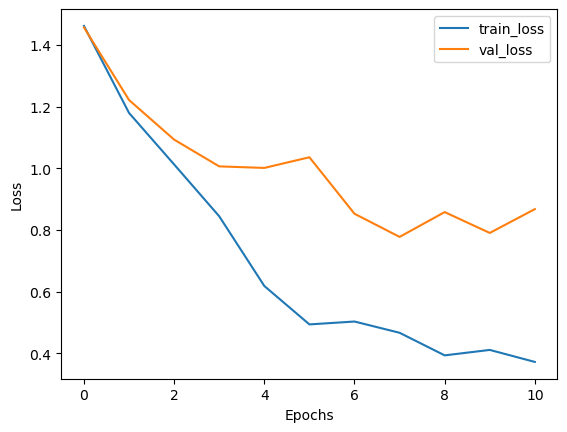

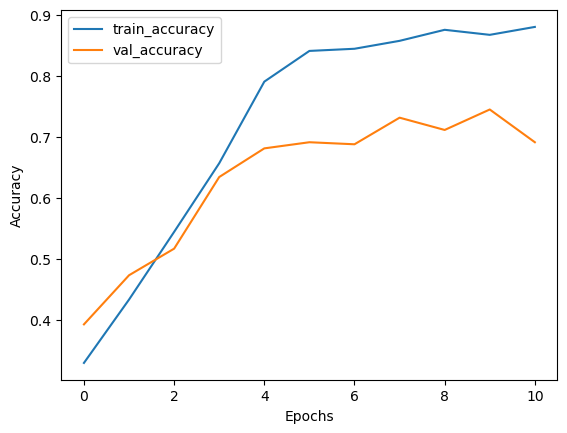

In [44]:

# Define learning rate
learning_rate = 0.001

# Compile the model within the specified device

V3_model.compile(optimizer=Adam(learning_rate=learning_rate),
                      loss='categorical_crossentropy',
                      metrics=["accuracy"])

# Define callbacks
callbacks = [
    EarlyStopping(monitor='val_loss', patience=3)
]

# Reduce batch size
batch_size = 16

# Train the model within the specified device

history = V3_model.fit(augmented_X_train, augmented_y_train,
                            validation_data=(V1_X_val, V1_y_val),
                            epochs=20, batch_size=batch_size,
                            callbacks=callbacks)

# Plot learning curves
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(history.history['accuracy'], label='train_accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


### Iteration 4

Trained a VGG16 model  using Adam optimizer with categorical crossentropy loss. Monitored validation accuracy with EarlyStopping and saved the best model with ModelCheckpoint. Trained for 10 epochs with a batch size of 32 on preprocessed training and validation data.


In [47]:

model_V4.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)
es = EarlyStopping(monitor='val_accuracy', mode='max', patience=2, restore_best_weights=True), 
ModelCheckpoint(filepath='best_model.h5', save_best_only=True),

history = model_V4.fit(V4_X_train_preprocessed, V4_y_train,
                       validation_data=(V4_X_val_preprocessed, V4_y_val),
                       epochs=10, batch_size=32,
                       callbacks=[es])

Epoch 1/10
33/33 [==============================] - 16s 283ms/step - loss: 1.7238 - accuracy: 0.7495 - val_loss: 0.4133 - val_accuracy: 0.9094
Epoch 2/10
33/33 [==============================] - 7s 200ms/step - loss: 0.3185 - accuracy: 0.9321 - val_loss: 0.3026 - val_accuracy: 0.9195
Epoch 3/10
33/33 [==============================] - 7s 201ms/step - loss: 0.0923 - accuracy: 0.9809 - val_loss: 0.2917 - val_accuracy: 0.9161
Epoch 4/10
33/33 [==============================] - 7s 205ms/step - loss: 0.0267 - accuracy: 0.9914 - val_loss: 0.2911 - val_accuracy: 0.9295
Epoch 5/10
33/33 [==============================] - 7s 206ms/step - loss: 0.0148 - accuracy: 0.9962 - val_loss: 0.2434 - val_accuracy: 0.9396
Epoch 6/10
33/33 [==============================] - 7s 203ms/step - loss: 0.0051 - accuracy: 0.9990 - val_loss: 0.2376 - val_accuracy: 0.9430
Epoch 7/10
33/33 [==============================] - 7s 205ms/step - loss: 0.0024 - accuracy: 0.9990 - val_loss: 0.2425 - val_accuracy: 0.9497
Epoch

## Task 3.5 Model Performance

### Iteration 1

Add your text here!

In [41]:


# Predict classes for the test set
y_pred = V1_model.predict(V1_X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Calculate precision, recall, F1-score, and support for each class
precision, recall, f1_score, support = precision_recall_fscore_support(np.argmax(V1_y_test, axis=1), y_pred_classes)

# Calculate accuracy for each class
class_accuracy = []
for i in range(len(class_names)):
    class_accuracy.append(np.sum((np.argmax(V1_y_test, axis=1) == i) & (np.argmax(V1_y_test, axis=1) == y_pred_classes)) / np.sum(np.argmax(V1_y_test, axis=1) == i))

# Calculate overall accuracy
accuracy = accuracy_score(np.argmax(V1_y_test, axis=1), y_pred_classes)

# Print performance metrics for each class
print("Performance Metrics for Each Class:")
for i, class_name in enumerate(class_names):
    print(f"Class: {class_name}")
    print(f"Precision: {precision[i]}")
    print(f"Recall: {recall[i]}")
    print(f"F1 Score: {f1_score[i]}")
    print(f"Accuracy: {class_accuracy[i]}")
    print()

# Print overall performance metrics
print("Overall Performance Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision.mean())
print("Recall:", recall.mean())
print("F1 Score:", f1_score.mean())

# Print confusion matrix
conf_matrix = confusion_matrix(np.argmax(V1_y_test, axis=1), y_pred_classes)
print("Confusion Matrix:")
print(conf_matrix)

5/5 [==============================] - 0s 7ms/step
Performance Metrics for Each Class:
Class: Accacia_flower
Precision: 0.6388888888888888
Recall: 0.8518518518518519
F1 Score: 0.7301587301587301
Accuracy: 0.8518518518518519

Class: Cypripedium_calceolus
Precision: 0.9411764705882353
Recall: 0.8
F1 Score: 0.8648648648648648
Accuracy: 0.8

Class: Rose
Precision: 0.72
Recall: 0.5806451612903226
F1 Score: 0.6428571428571428
Accuracy: 0.5806451612903226

Class: edelvais
Precision: 0.75
Recall: 0.75
F1 Score: 0.75
Accuracy: 0.75

Class: tulips
Precision: 0.7142857142857143
Recall: 0.78125
F1 Score: 0.7462686567164178
Accuracy: 0.78125

Overall Performance Metrics:
Accuracy: 0.7534246575342466
Precision: 0.7528702147525677
Recall: 0.7527494026284349
F1 Score: 0.7468298789194311
Confusion Matrix:
[[23  1  1  2  0]
 [ 5 32  0  1  2]
 [ 3  1 18  1  8]
 [ 4  0  0 12  0]
 [ 1  0  6  0 25]]


### Iteration 2

Add your text here!

In [42]:


# Predict classes for the test set
y_pred = V2_model.predict(V2_X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Calculate precision, recall, F1-score, and support for each class
precision, recall, f1_score, support = precision_recall_fscore_support(np.argmax(V2_y_test, axis=1), y_pred_classes)

# Calculate accuracy for each class
class_accuracy = []
for i in range(len(class_names)):
    class_accuracy.append(np.sum((np.argmax(V2_y_test, axis=1) == i) & (np.argmax(V2_y_test, axis=1) == y_pred_classes)) / np.sum(np.argmax(V2_y_test, axis=1) == i))

# Calculate overall accuracy
accuracy = accuracy_score(np.argmax(V2_y_test, axis=1), y_pred_classes)

# Print performance metrics for each class
print("Performance Metrics for Each Class:")
for i, class_name in enumerate(class_names):
    print(f"Class: {class_name}")
    print(f"Precision: {precision[i]}")
    print(f"Recall: {recall[i]}")
    print(f"F1 Score: {f1_score[i]}")
    print(f"Accuracy: {class_accuracy[i]}")
    print()

# Print overall performance metrics
print("Overall Performance Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision.mean())
print("Recall:", recall.mean())
print("F1 Score:", f1_score.mean())

# Print confusion matrix
conf_matrix = confusion_matrix(np.argmax(V2_y_test, axis=1), y_pred_classes)
print("Confusion Matrix:")
print(conf_matrix)

5/5 [==============================] - 0s 45ms/step
Performance Metrics for Each Class:
Class: Accacia_flower
Precision: 0.625
Recall: 0.7407407407407407
F1 Score: 0.6779661016949152
Accuracy: 0.7407407407407407

Class: Cypripedium_calceolus
Precision: 0.7755102040816326
Recall: 0.95
F1 Score: 0.8539325842696629
Accuracy: 0.95

Class: Rose
Precision: 0.6896551724137931
Recall: 0.6451612903225806
F1 Score: 0.6666666666666667
Accuracy: 0.6451612903225806

Class: edelvais
Precision: 1.0
Recall: 0.625
F1 Score: 0.7692307692307693
Accuracy: 0.625

Class: tulips
Precision: 0.8076923076923077
Recall: 0.65625
F1 Score: 0.7241379310344829
Accuracy: 0.65625

Overall Performance Metrics:
Accuracy: 0.7465753424657534
Precision: 0.7795715368375467
Recall: 0.7234304062126642
F1 Score: 0.7383868105792993
Confusion Matrix:
[[20  7  0  0  0]
 [ 2 38  0  0  0]
 [ 4  2 20  0  5]
 [ 5  0  1 10  0]
 [ 1  2  8  0 21]]


### Iteration 3

Add your text here!

In [45]:
# Predict classes for the test set
y_pred = V3_model.predict(V1_X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Calculate precision, recall, F1-score, support for each class
precision, recall, f1_score, support = precision_recall_fscore_support(np.argmax(V1_y_test, axis=1), y_pred_classes)

# Calculate accuracy for each class
class_accuracy = []
for i in range(len(class_names)):
    class_accuracy.append(np.sum((np.argmax(V1_y_test, axis=1) == i) & (np.argmax(V1_y_test, axis=1) == y_pred_classes)) / np.sum(np.argmax(V1_y_test, axis=1) == i))

# Calculate overall accuracy
accuracy = accuracy_score(np.argmax(V1_y_test, axis=1), y_pred_classes)

# Print performance metrics for each class
print("Performance Metrics for Each Class:")
for i, class_name in enumerate(class_names):
    print(f"Class: {class_name}")
    print(f"Precision: {precision[i]}")
    print(f"Recall: {recall[i]}")
    print(f"F1 Score: {f1_score[i]}")
    print(f"Accuracy: {class_accuracy[i]}")
    print()

# Print overall performance metrics
print("Overall Performance Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision.mean())
print("Recall:", recall.mean())
print("F1 Score:", f1_score.mean())

# Print confusion matrix
conf_matrix = confusion_matrix(np.argmax(V1_y_test, axis=1), y_pred_classes)
print("Confusion Matrix:")
print(conf_matrix)


5/5 [==============================] - 0s 25ms/step
Performance Metrics for Each Class:
Class: Accacia_flower
Precision: 0.5813953488372093
Recall: 0.9259259259259259
F1 Score: 0.7142857142857142
Accuracy: 0.9259259259259259

Class: Cypripedium_calceolus
Precision: 0.7948717948717948
Recall: 0.775
F1 Score: 0.7848101265822786
Accuracy: 0.775

Class: Rose
Precision: 0.875
Recall: 0.6774193548387096
F1 Score: 0.7636363636363636
Accuracy: 0.6774193548387096

Class: edelvais
Precision: 0.7333333333333333
Recall: 0.6875
F1 Score: 0.7096774193548386
Accuracy: 0.6875

Class: tulips
Precision: 0.84
Recall: 0.65625
F1 Score: 0.736842105263158
Accuracy: 0.65625

Overall Performance Metrics:
Accuracy: 0.7465753424657534
Precision: 0.7649200954084675
Recall: 0.7444190561529271
F1 Score: 0.7418503458244705
Confusion Matrix:
[[25  1  0  1  0]
 [ 9 31  0  0  0]
 [ 3  2 21  1  4]
 [ 4  1  0 11  0]
 [ 2  4  3  2 21]]


### Iteration 4 

In [48]:


# Predict classes for the test set
y_pred = model_V4.predict(V4_X_test_preprocessed)
y_pred_classes = np.argmax(y_pred, axis=1)

# Calculate precision, recall, F1-score, and support for each class
precision, recall, f1_score, support = precision_recall_fscore_support(np.argmax(V4_y_test, axis=1), y_pred_classes)

# Calculate accuracy for each class
class_accuracy = []
for i in range(len(class_names)):
    class_accuracy.append(np.sum((np.argmax(V4_y_test, axis=1) == i) & (np.argmax(V4_y_test, axis=1) == y_pred_classes)) / np.sum(np.argmax(V4_y_test, axis=1) == i))

# Calculate overall accuracy
accuracy = accuracy_score(np.argmax(V4_y_test, axis=1), y_pred_classes)

# Print performance metrics for each class
print("Performance Metrics for Each Class:")
for i, class_name in enumerate(class_names):
    print(f"Class: {class_name}")
    print(f"Precision: {precision[i]}")
    print(f"Recall: {recall[i]}")
    print(f"F1 Score: {f1_score[i]}")
    print(f"Accuracy: {class_accuracy[i]}")
    print()

# Print overall performance metrics
print("Overall Performance Metrics:")
print("Accuracy:", accuracy)
print("Precision:", precision.mean())
print("Recall:", recall.mean())
print("F1 Score:", f1_score.mean())

# Print confusion matrix
conf_matrix = confusion_matrix(np.argmax(V4_y_test, axis=1), y_pred_classes)
print("Confusion Matrix:")
print(conf_matrix)

5/5 [==============================] - 1s 164ms/step
Performance Metrics for Each Class:
Class: Accacia_flower
Precision: 0.8666666666666667
Recall: 0.9629629629629629
F1 Score: 0.912280701754386
Accuracy: 0.9629629629629629

Class: Cypripedium_calceolus
Precision: 1.0
Recall: 1.0
F1 Score: 1.0
Accuracy: 1.0

Class: Rose
Precision: 0.9285714285714286
Recall: 0.8387096774193549
F1 Score: 0.8813559322033899
Accuracy: 0.8387096774193549

Class: edelvais
Precision: 1.0
Recall: 0.875
F1 Score: 0.9333333333333333
Accuracy: 0.875

Class: tulips
Precision: 0.8529411764705882
Recall: 0.90625
F1 Score: 0.8787878787878787
Accuracy: 0.90625

Overall Performance Metrics:
Accuracy: 0.9246575342465754
Precision: 0.9296358543417366
Recall: 0.9165845280764635
F1 Score: 0.9211515692157978
Confusion Matrix:
[[26  0  0  0  1]
 [ 0 40  0  0  0]
 [ 1  0 26  0  4]
 [ 2  0  0 14  0]
 [ 1  0  2  0 29]]


## Task 3.6 Error Analysis

### Iteration 1

Add your text here!

In [50]:

import matplotlib.pyplot as plt
import numpy as np

def visualize_misclassifications(images, predicted_labels, actual_labels, class_names, figsize=(75, 75), title_fontsize=50):
    error_categories = {
        'Background Confusion': [],
        'Occlusions': [],
        'Scale Variations': [],
        'Lighting and Exposure Issues': [],
        'Color Variations': [],
        'Pose and Orientation Variability': [],
        'Image Quality and Noise': [],
        'Contextual Misunderstandings': [],
        'Inter-Class Similarity': [],
        'Intra-Class Variability': []
    }
    
    num_images = len(images)
    num_cols = 3
    num_rows = (num_images + num_cols - 1) // num_cols
    
    plt.figure(figsize=figsize)
    
    for i in range(num_images):
        predicted_label = predicted_labels[i]
        actual_label = actual_labels[i]
        image = images[i]
        
        # Plot each image
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(image)
        plt.title(f'Predicted: {class_names[predicted_label]}, Actual: {class_names[actual_label]}', fontsize=title_fontsize)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return error_categories


5/5 [==============================] - 0s 6ms/step


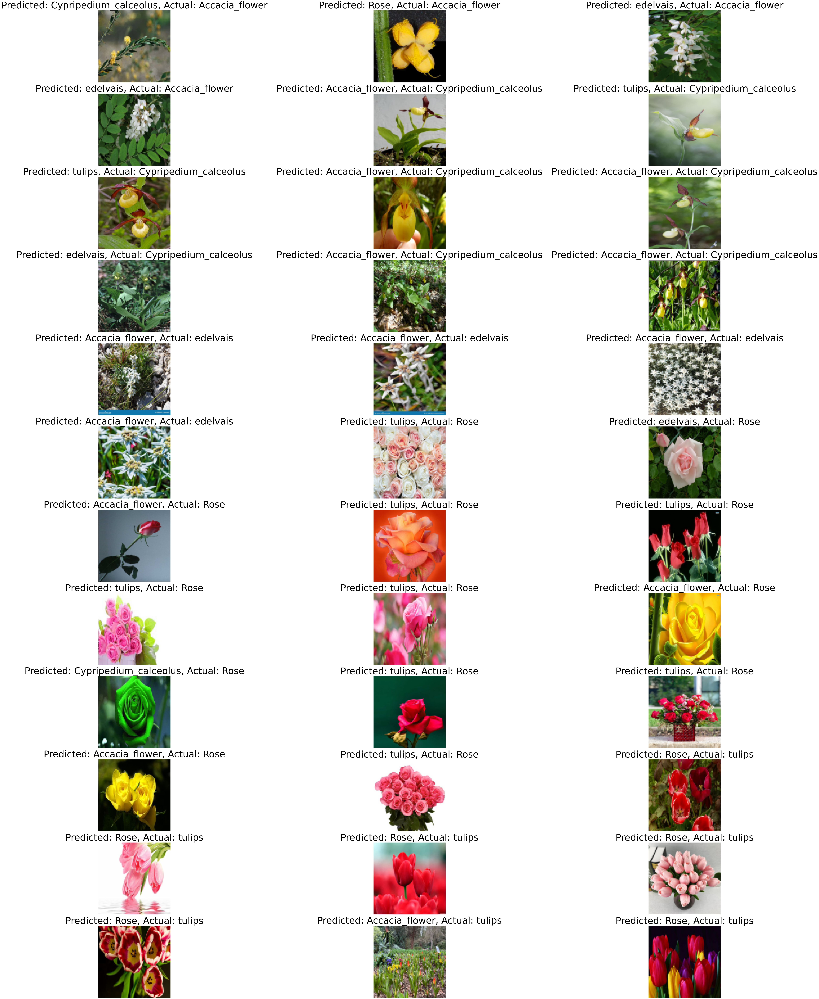

In [51]:
# Get predictions on the test set
V1_predictions = V1_model.predict(V1_X_test)

# Convert predictions and true labels to class indices
V1_predicted_labels = np.argmax(V1_predictions, axis=1)
V1_actual_labels = np.argmax(V1_y_test, axis=1)

# Find instances where predictions do not match labels
V1_mismatches = np.where(V1_predicted_labels != V1_actual_labels)[0]

# Store the misclassified images
V1_wrong_predictions = V1_X_test[V1_mismatches]

# Perform error analysis using the visualize_misclassifications function
V1_error_categories = visualize_misclassifications(V1_wrong_predictions, V1_predicted_labels[V1_mismatches], V1_actual_labels[V1_mismatches], class_names)


- Most of the images look like get edelvais when the color of the picture is white. But when there is yellow in the picture it predicts most of the time accacia. In the end my biggest problem is with tulips and rose to apart them from each other. 

### Iteration 2

Add your text here!

In [52]:
# Get predictions on the test set
V2_predictions = V2_model.predict(V2_X_test)

# Convert predictions and true labels to class indices
V2_predicted_labels = np.argmax(V2_predictions, axis=1)
V2_actual_labels = np.argmax(V2_y_test, axis=1)

# Find instances where predictions do not match labels
V2_mismatches = np.where(V2_predicted_labels != V2_actual_labels)[0]

# Store the misclassified images
V2_wrong_predictions = V2_X_test[V2_mismatches]

# Perform error analysis using the visualize_misclassifications function
V2_error_categories = visualize_misclassifications(V2_wrong_predictions, V2_predicted_labels[V2_mismatches], V2_actual_labels[V2_mismatches], class_names)


5/5 [==============================] - 0s 46ms/step


### Iteration 3

Add your text here!

In [53]:
# Get predictions on the test set
V3_predictions = V3_model.predict(V1_X_test)

# Convert predictions and true labels to class indices
V3_predicted_labels = np.argmax(V3_predictions, axis=1)
V3_actual_labels = np.argmax(V1_y_test, axis=1)

# Find instances where predictions do not match labels
V3_mismatches = np.where(V3_predicted_labels != V3_actual_labels)[0]

# Store the misclassified images
V3_wrong_predictions = V1_X_test[V3_mismatches]

# Perform error analysis using the visualize_misclassifications function
V3_error_categories = visualize_misclassifications(V3_wrong_predictions, V3_predicted_labels[V3_mismatches], V3_actual_labels[V3_mismatches], class_names)


5/5 [==============================] - 0s 12ms/step


### Iteration 4

## Task 3.7 MLP From Scratch

In [ ]:
train_dir = "D://Holland Обучение//Block_C//Dataset//Train 70 %"
test_dir = "D://Holland Обучение//Block_C//Dataset//Test 10 %"
val_dir = "D://Holland Обучение//Block_C//Dataset//Validation 20 %"

#### The architecture of the model 

In [56]:
nn_architecture = [2, 3, 1]

#### layer indentification 

In [57]:
layer_id = 1
units = nn_architecture[layer_id]
print(f'There are {units} units in layer {layer_id}.')

There are 3 units in layer 1.


#### loading the dataset 

In [62]:
import os
import numpy as np
import matplotlib.pyplot as plt

def load_images_from_dir(directory):
    images = []
    labels = []
    for label in os.listdir(directory):
        label_dir = os.path.join(directory, label)
        for image_file in os.listdir(label_dir):
            image_path = os.path.join(label_dir, image_file)
            # Read image file using NumPy
            with open(image_path, 'rb') as f:
                image_data = plt.imread(f, format='jpeg')  # Read JPEG images
            images.append(image_data)
            labels.append(int(label))  # Assuming labels are folder names
    return np.array(images), np.array(labels)

# Load training, testing, and validation data
train_dir = "D://Holland Обучение//Block_C//Dataset//Train 70 %"
test_dir = "D://Holland Обучение//Block_C//Dataset//Test 10 %"
val_dir = "D://Holland Обучение//Block_C//Dataset//Validation 20 %"

X_train, y_train = load_images_from_dir(train_dir)
X_test, y_test = load_images_from_dir(test_dir)
X_val, y_val = load_images_from_dir(val_dir)

# Reshape images to flatten them
X_train = X_train.reshape(X_train.shape[0], -1)
X_test = X_test.reshape(X_test.shape[0], -1)
X_val = X_val.reshape(X_val.shape[0], -1)

# Normalize pixel values to range [0, 1]
X_train = X_train / 255.0
X_test = X_test / 255.0
X_val = X_val / 255.0


ValueError: invalid literal for int() with base 10: 'Accacia_flower'

# Section 4 - Human-Centered AI (Weeks 7 and 8)

## Task 4.1: Think-Aloud Study

https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/Task%204.1%20Think_Aloud_Study/Think_aloud_study_feedback.txt

## Task 4.2: A/B Testing

(https://forms.office.com/e/6EfuDfEh8r) Form A 

https://forms.office.com/e/MK5e2pxZLA Form B 

https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/AB_test/A_B_Test_A.xlsx test_ A

https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/AB_test/A_B_Test_B.xlsx test_B 





## Task 4.3:  Create a Final Wireframe and Demo Video


<video controls src="https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/Video%20for%20the%20wireframe/Untitled%20video%20-%20Made%20with%20Clipchamp.mp4" title=""></video>

"https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/Video%20for%20the%20wireframe/Untitled%20video%20-%20Made%20with%20Clipchamp.mp4"

# Section 5 - Final Project Presentation (Week 8)

## Task 5: Presentation Slides

[Presentaion](https://github.com/BredaUniversityADSAI/2023-24c-fai1-adsai-PetarPaskalev232725/blob/main/Deliverables/Final_deliverables/Project-Presentation.pptx)